<a href="https://colab.research.google.com/github/AryanSahu13/LWSMajorProject/blob/main/LWSMajorProject.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Aryan Sahu, Major Project, Learnwik Solutions

#**Major Project: Object Tracking using OpenCV and Deep Learning**

Major Project number 3 of Learnwik Solutions

Dataset: Any video dataset with moving objects
Algorithm: OpenCV and Deep Learning

Methodology:
1. Load the video and extract frames from it.
2. Use an object detection algorithm like YOLO or SSD to detect objects in the first frame
3. Track the detected objects in subsequent frames using techniques like Optical Flow or Kalman Filters

Step -1:Install the necessary libraries 

In [1]:
!pip install opencv-python
!pip install opencv-contrib-python
!pip install numpy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Step-2: Import the required libraries:

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt


Step-3: Mount Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


Step-4: Load the video and extract frames:
Upload the video file to your Google Colab environment.
Use the following code to load the video and extract frames:

PS: The required video for this project is downloaded from youtube. The video link is - https://www.youtube.com/watch?v=fyd3PDnYK2w&t=7s

In [ ]:
# Replace 'video_path' with the path to your video file
video_path = '/content/VIDEO/videoplayback.webm'

# Open the video file
cap = cv2.VideoCapture(video_path)

# Check if the video file opened successfully
if not cap.isOpened():
    print("Error opening video file")
    exit()

frames = []
while True:
    # Read the next frame from the video
    ret, frame = cap.read()

    # If the frame was not read successfully, then we have reached the end of the video
    if not ret:
        break

    # Store the frame
    frames.append(frame)

# Release the video file
cap.release()


Step-5: Use an object detection algorithm:
Choose an object detection algorithm like YOLO or SSD.
Download the pre-trained weights and configuration files for the chosen algorithm.
Use the following code to load the model:

PS:

1)The .weights file required for yolo algorithm is downloaded from https://pjreddie.com/darknet/yolo/

2)The .cfg file required for yolo algorithm is downloaded from (https://github.com/AlexeyAB/darknet)

Download the required files, add them to colab environment and then execute the code by specifying the path.

In [ ]:
# Load the pre-trained weights and configuration file for the object detection model
model_weights = '/content/YOLO Files/Weights/yolov3.weights'
model_config = '/content/YOLO Files/CFG/yolov7.cfg'

net = cv2.dnn.readNetFromDarknet(model_config, model_weights)

output_layers = net.getUnconnectedOutLayersNames()


Step-6: Track the objects in subsequent frames:
Use techniques like Optical Flow or Kalman Filters for object tracking.
Implement the chosen tracking method using the following code and run it.

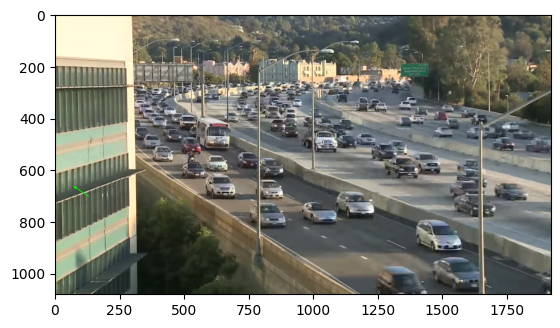

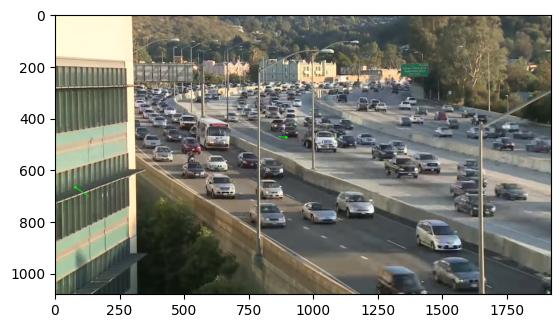

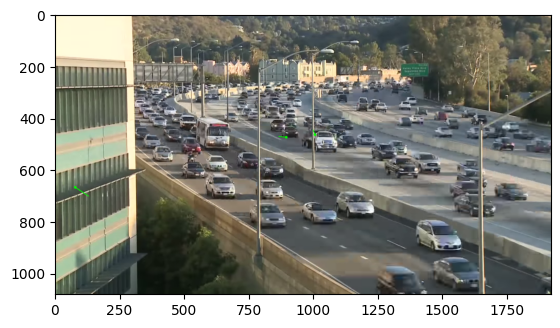

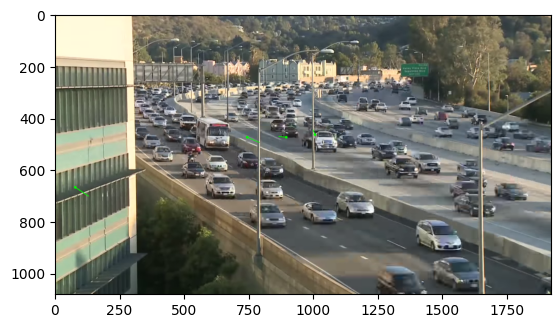

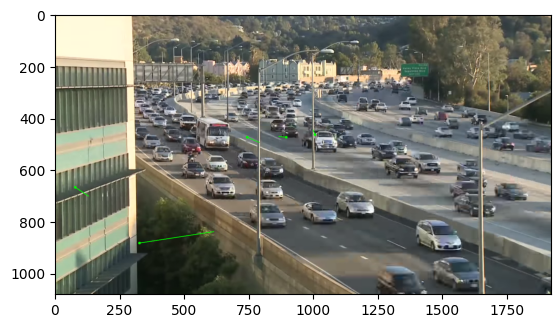

...

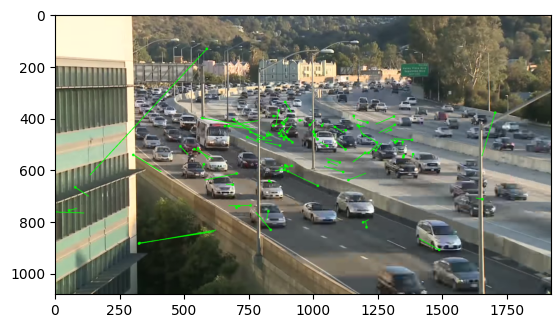

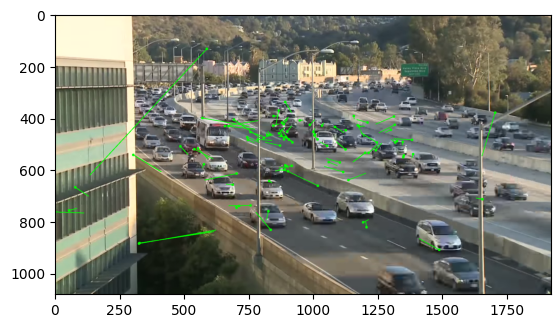

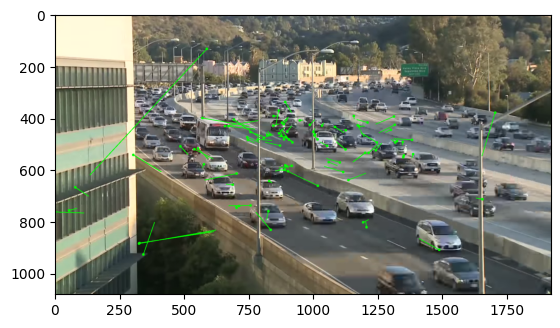

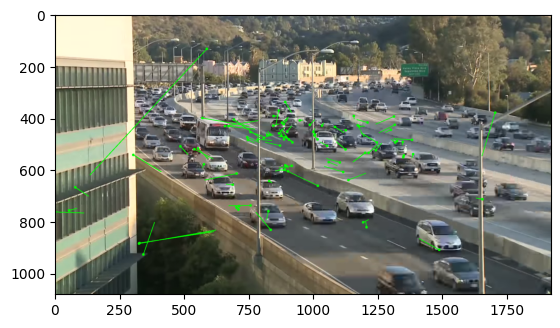

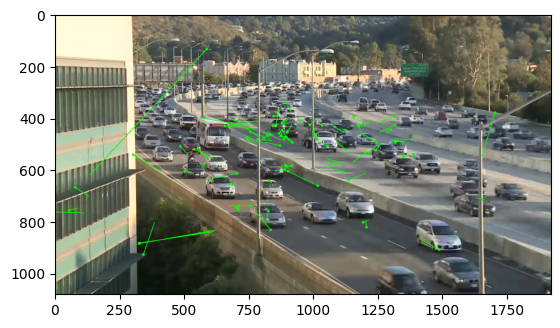

In [ ]:
# Object tracking using Optical Flow
frame_gray_prev = cv2.cvtColor(frames[0], cv2.COLOR_BGR2GRAY)
prev_points = cv2.goodFeaturesToTrack(frame_gray_prev, maxCorners=100, qualityLevel=0.3, minDistance=7)

for i in range(1, len(frames)):
    frame_gray_curr = cv2.cvtColor(frames[i], cv2.COLOR_BGR2GRAY)
    curr_points, status, _ = cv2.calcOpticalFlowPyrLK(frame_gray_prev, frame_gray_curr, prev_points, None)

    # Filter out points with low status
    good_new = curr_points[status == 1]
    good_old = prev_points[status == 1]

# Display the tracked objects
for j, (new, old) in enumerate(zip(good_new, good_old)):
    x1, y1 = new.ravel()
    x0, y0 = old.ravel()
    pt1 = (int(x1), int(y1))  # Ensure the points are integers
    pt0 = (int(x0), int(y0))  # Ensure the points are integers
    cv2.line(frames[i], pt1, pt0, (0, 255, 0), 2)
    cv2.circle(frames[i], pt1, 5, (0, 255, 0), -1)

    # Update the previous frame and points
    frame_gray_prev = frame_gray_curr.copy()
    prev_points = good_new.reshape(-1, 1, 2)

    # Display the frame with tracked objects
    plt.imshow(cv2.cvtColor(frames[i], cv2.COLOR_BGR2RGB))
    plt.show()
    
    if cv2.waitKey(1) == ord('q'):
        break

cv2.destroyAllWindows()

As seen above, this is a successful implementation of Object Tracking using OpenCV and Deep Learning as, after running all the code cells in the notebook, the object tracking process will start, and we can see a window displaying the video frames with the tracked objects.
